## 1. Prepare Dataset

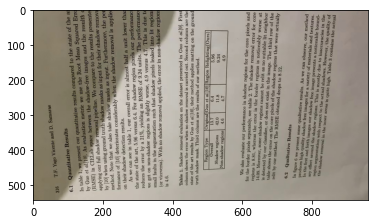

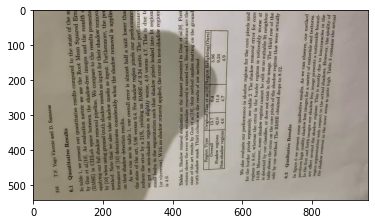

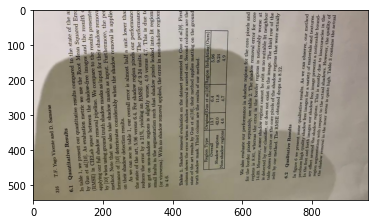

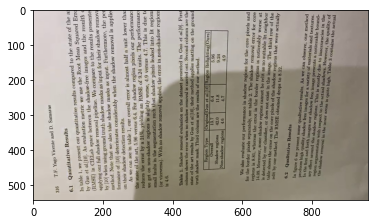

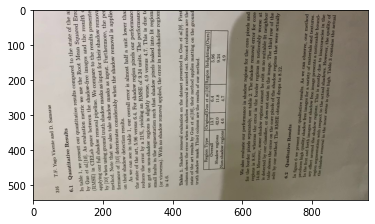

...

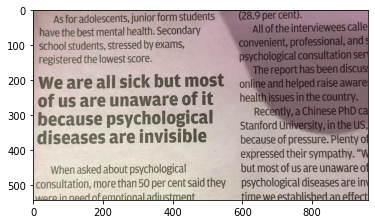

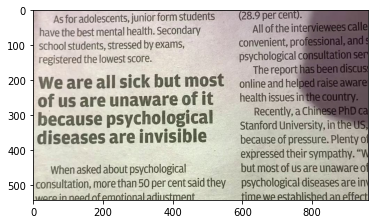

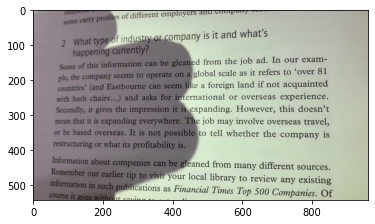

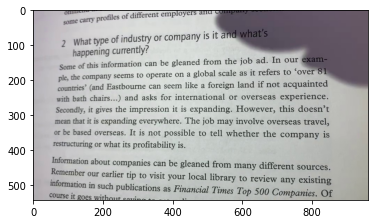

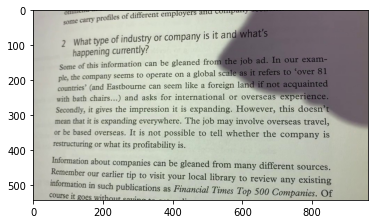

In [2]:
import pandas as pd
import os
from IPython.display import display, Math, Latex
from skimage.util import random_noise
import numpy as np
import matplotlib.pyplot as plt
from sklearn.cluster import KMeans
from PIL import Image, ImageTk,ImageGrab
import cv2
from scipy import signal
from scipy import misc

import os
import tkinter as ttk
from tkinter import *
import tkinter.messagebox
from PIL import Image, ImageTk,ImageGrab
from tkinter.filedialog import askopenfilename
import cv2

IMAGES=[]
with open("DocumentShadowRemoval-master/Control.txt", "r") as a_file:
    for line in a_file:
        path = line.strip()
        image=Image.open("DocumentShadowRemoval-master/Control_Original01/Control_Original01/"+path)
        plt.imshow(image)
        plt.show()
        IMAGES.append(image)




## 2. Local K-means clustering which has blurred boundaries but has better global background

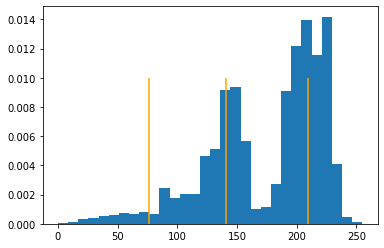

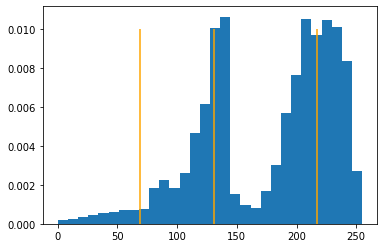

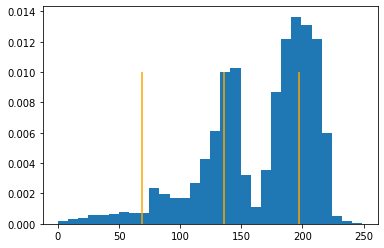

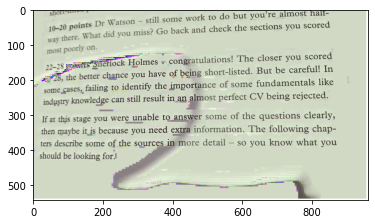

In [4]:
    img=IMAGES[100]
    im=np.asarray(img);
    ans=np.uint8(np.ones(np.shape(img)))*255;
    x1=10
    for channel in range(0,3):
        
        

        combined = np.vstack((np.zeros(len(im[:,:,channel].flatten())), np.array(im[:,:,channel].flatten()))).T
        kmeans = KMeans(n_clusters=3, random_state=0).fit(combined)
        c1,c2,c3=kmeans.cluster_centers_
        g=int(max(c1[1],c2[1],c3[1]))
        plt.hist(im[:,:,channel].flatten(), density=True, bins=30)
        plt.vlines([c1[1],c2[1],c3[1]],ymin=0,ymax=0.01,color='orange')
        plt.show()


        for i in range(x1,np.shape(im)[0]-x1,int(x1/2)):
            for j in range(x1,np.shape(im)[1]-x1,int(x1/2)):
                A=np.array(im[i-x1:i+x1,j-x1:j+x1,channel].flatten())
                mx=max(A);mn=min(A)
                
                if(mx-mn>=20):
                    
                    combined = np.vstack((np.zeros(len(im[i-x1:i+x1,j-x1:j+x1,channel].flatten())), np.array(im[i-x1:i+x1,j-x1:j+x1,channel].flatten()))).T
                    kmeans = KMeans(n_clusters=2, random_state=0).fit(combined)
                    c1,c2=kmeans.cluster_centers_
                
                    
                    for row in range(i-x1,i+x1):
                         for col in range(j-x1,j+x1):
                                if(abs(im[row][col][channel]-mn)>20):
                                    alpha=(max(c1[1],c2[1])/g)
                                    ans[row][col][channel]=int(im[row][col][channel]/alpha)
                                   
                                else :
                                    ans[row][col][channel]=int(im[row][col][channel])
                else :
                    
                    for row in range(i-x1,i+x1):
                         for col in range(j-x1,j+x1):
                                ans[row][col][channel]=int(g)
                  
               
        
        
        
    
    
    plt.imshow(ans)
    plt.show()

## 3. Binarization using Global K-means clustering


[49, 194, 44, 199, 50, 191]


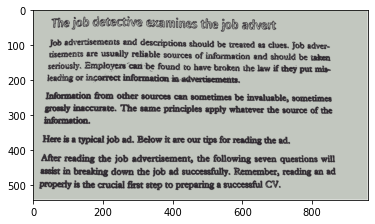

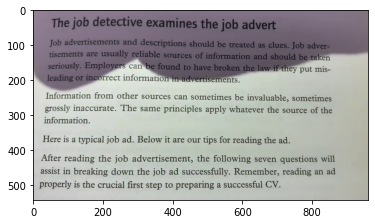

In [6]:
img=IMAGES[151]
imgage=np.asarray(img);im=np.asarray(img);
ans=np.uint8(np.ones(np.shape(img)))*255;l=[];
g=[]
for k in range(0,3):
    combined = np.vstack((np.zeros(len(im[:,:,k].flatten())), np.array(im[:,:,k].flatten()))).T
    kmeans = KMeans(n_clusters=3, random_state=0).fit(combined)
    c1,c2,c3=kmeans.cluster_centers_
    g.append(int(min(c1[1],c2[1],c3[1])))
    g.append(int(max(c1[1],c2[1],c3[1])))

print(g)
def gradient(x,y):
    s=int(abs(int(imgage[x+1][y+1][0])-int(imgage[x][y][0]))+
    abs(int(imgage[x-1][y-1][0])-int(imgage[x][y][0]))+
    abs(int(imgage[x+1][y][0])-int(imgage[x][y][0]))+
    abs(int(imgage[x-1][y][0])-int(imgage[x][y][0]))+
    abs(int(imgage[x][y+1][0])-int(imgage[x][y][0]))+
    abs(int(imgage[x][y-1][0])-int(imgage[x][y][0])));
    return s;

for i in range(1,np.shape(im)[0]-1):
            for j in range(1,np.shape(im)[1]-1):
                a=gradient(i,j);l.append(a)
                if a >=100  :
                    ans[i][j][0]=g[0]; ans[i][j][1]=g[2]; ans[i][j][2]=g[4];
                

for k in range(0,3):
    for i in range(1,np.shape(im)[0]-1):
                for j in range(1,np.shape(im)[1]-1):
                    if(ans[i][j][k]==g[0] or ans[i][j][k]==g[2] or ans[i][j][k]==g[4]):
                        ;
                    else :
                        ans[i][j][k]=g[2*k+1]
        
#plt.hist(l, density=True, bins=30)
#plt.show()
plt.imshow(ans)
plt.show()
plt.imshow(img)
plt.show()
#plt.imshow(img)
#plt.show()

## 4. Observing some RGB/HSV properties of shadow and non shadow regions
### Shadow had darker shade(hue) compared to global back-ground and lighter shade than text and the intensity was higher for global background(brighter) and less for text/shadow(darker)

[124 125 125 125 126 125 125 125 127 127 127 127 127 127 127 127 127 127
 127 127 127 127 127 127 127 127 127 127 127 127 128 128 128 129 129 129
 129 129 129 129 129 129 129 129 129 129 129 129 129 129 129 129 129 129
 129 129 128 128 129 129 131 133 134 135 136 139 144 151 154 157 159 162
 171 176 181 184 185 183 185 191 201 207 211 216 220 222 224 225 229 229
 232 235 238 238 239 239 239 238 239 241] (544, 960)
[130 130 130 140 140 140 140 150 144 144 144 144 144 144 144 144 144 144
 144 144 144 144 144 144 144 144 144 144 144 144 144 144 144 144 144 144
 144 144 144 144 144 144 144 144 144 144 144 144 144 144 144 144 144 144
 144 144 144 144 144 144 144 144 144 144 160 135 135 128 114 107  96  95
  86  80  75  75  75  77  77  77  77  77  77  74  74  74  75  75  73  73
  74  74  74  74  74  74  72  72  72  72]


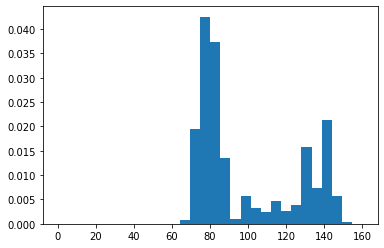

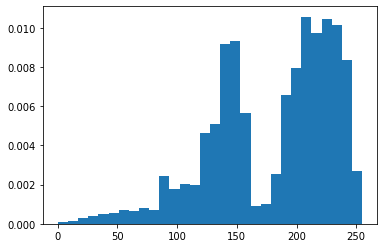

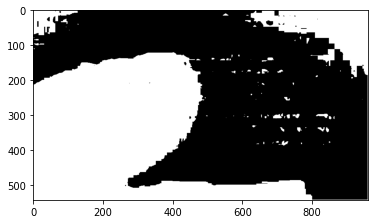

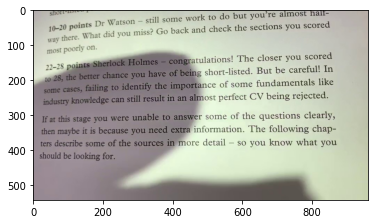

In [4]:
#img=Image.open("SBU-shadow/SBU-Test/ShadowImages/0.jpg")
#imgage=np.asarray(img)
hsvImage = cv2.cvtColor(imgage, cv2.COLOR_BGR2HSV)
h,s,v=cv2.split(hsvImage)
print(v[200,400:500],np.shape(v))
print(h[200,400:500])
#print(s[200])
plt.hist(h.flatten(), density=True, bins=30)
plt.show()

#plt.hist(s.flatten(), density=True, bins=30)
#plt.show()

plt.hist(v.flatten(), density=True, bins=30)
plt.show()

ans=np.uint8(np.ones(np.shape(img)))*255;
for i in range(0,np.shape(img)[0]-1):
                for j in range(0,np.shape(img)[1]-1):
                    if(h[i][j]<90 ):
                        ans[i][j][0]=0;ans[i][j][1]=0;ans[i][j][2]=0

plt.imshow(ans)
plt.show()
plt.imshow(img)
plt.show()
